In [1]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
from helpers.collection_of_experiments import CollectionOfExperiments
from helpers.plot_helpers import *
from helpers.computational_tools import *
from mpl_toolkits.axes_grid1 import make_axes_locatable
import cmocean
import os
%load_ext autoreload
%autoreload 2
import warnings
warnings.filterwarnings("ignore")
import hvplot.xarray
import holoviews as hv
hvplot.output(widget_location='bottom')

In [10]:
def logKEz(ds):
    return np.log10(0.5 * (ds.h * (remesh(ds.u**2, ds.e) + remesh(ds.v**2, ds.e))).sum('zl'))

In [119]:
# R2 instability
ds = xr.open_mfdataset('/scratch/pp2681/mom6/Neverworld2/simulations/R2/Smooth_instability/output/debugs*', decode_times=False, chunks={'time':1})
static = xr.open_mfdataset('/scratch/pp2681/mom6/Neverworld2/simulations/R2/Smooth_instability/output/static.nc', decode_times=False)

In [93]:
# R4 instability
files = ['/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/Instability_testing/visc_limit/snapshots_4965'+str(i)+'.nc' for i in range(7000,8390,10)]
ds = xr.open_mfdataset(files, decode_times=False, chunks={'time':1})
ds['time'] = np.arange(len(ds.time))
static = xr.open_mfdataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_smooth_Klower_1.3_new_cdiss/output/static.nc', decode_times=False)

# Stress tensor components

In [120]:
dudx = diffx_tv(ds.u, ds.h) / remesh(static.dxCu, ds.h)

In [121]:
dudy = diffy_vq(ds.u, ds.RV) / remesh(static.dyCu, ds.RV)

In [122]:
dvdx = diffx_uq(ds.v, ds.RV) / remesh(static.dxCu, ds.RV)

In [123]:
dvdy = diffy_tu(ds.v, ds.h) / remesh(static.dyCu, ds.h)

In [124]:
D = remesh(np.abs(dudy+dvdx),ds.h)

In [125]:
D_hat = np.abs(dudx-dvdy)

In [126]:
rot = remesh(np.abs(dvdx-dudy), ds.h)

In [127]:
div = np.abs(dudx + dvdy)

In [128]:
div_h = np.abs(diffx_tv(ds.u * remesh(ds.h,ds.u), ds.h) / remesh(static.dxCu, ds.h) / ds.h + \
        diffy_tu(ds.v * remesh(ds.h,ds.v), ds.h) / remesh(static.dyCu, ds.h) / ds.h)

In [131]:
size = {'width': 300, 'height': 400, 'colorbar': True}
((ds.u).hvplot(x='xq', y='yh', clim=(-1,1), cmap='bwr', label='Zonal velocity', **size) + \
ds.h.hvplot(x='xh', y='yh', cmap='inferno', label='Thickness', **size) + \
np.sqrt(D**2+D_hat**2).hvplot(x='xh', y='yh', cmap='viridis', label='sqrt(D**2+D_hat**2)', **size) + \
np.sqrt(div**2).hvplot(x='xh', y='yh', cmap='viridis', label='sqrt(div**2)', **size)
).cols(2)


:Layout
   .DynamicMap.I   :DynamicMap   [time,zl]
      :Image   [xq,yh]   (u)
   .DynamicMap.II  :DynamicMap   [time,zl]
      :Image   [xh,yh]   (h)
   .DynamicMap.III :DynamicMap   [time,zl]
      :Image   [xh,yh]   (sqrt(D**2+D_hat**2))
   .DynamicMap.IV  :DynamicMap   [time,zl]
      :Image   [xh,yh]   (sqrt(div**2))

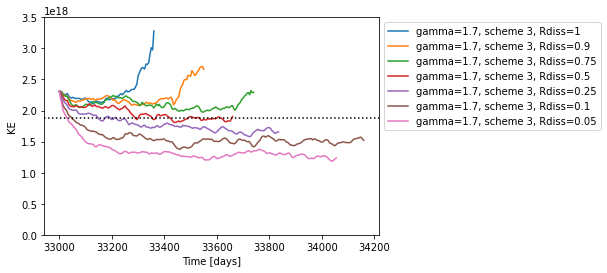

In [209]:
def fun(ds):
    return ds.KE.sum('Layer')
#    return ds.APE.sum('Interface')
#fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_smooth_Klower/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.1')
# fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_smooth_Klower_1.3/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.3')
# fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_smooth_Klower_0.9/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=0.9')
# fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_smooth_1m_0.9/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=0.9, mask')
# fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_smooth_Klower_Rdiss_0.5/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.1, $R_{diss}=0.5$')
# fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_smooth_Klower_Rdiss_0.1/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.1, $R_{diss}=0.1$')
#fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_smooth_Klower_1.1_new_cdiss/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.1, 2nd power')
#fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_smooth_Klower_1.3_new_cdiss/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.3, 2nd power')
#fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/ZB_smooth_1.3/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.3, 4th power')
#fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/ZB_smooth_1.5/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.5, 4th power')
#fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/ZB_smooth_1.7/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.7, 4th power')
#fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/stability_test/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.7, smooth c-diss')
fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/stability_Rdiss_1/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.7, scheme 3, Rdiss=1')
fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/stability_Rdiss_0.9/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.7, scheme 3, Rdiss=0.9')
fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/stability_Rdiss_0.75/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.7, scheme 3, Rdiss=0.75')
fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/stability_Rdiss_0.5/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.7, scheme 3, Rdiss=0.5')
fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/stability_Rdiss_0.25/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.7, scheme 3, Rdiss=0.25')
fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/stability_Rdiss_0.1/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.7, scheme 3, Rdiss=0.1')
fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/stability_Rdiss_0.05/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.7, scheme 3, Rdiss=0.05')

plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18])
plt.legend(bbox_to_anchor=(1,1))

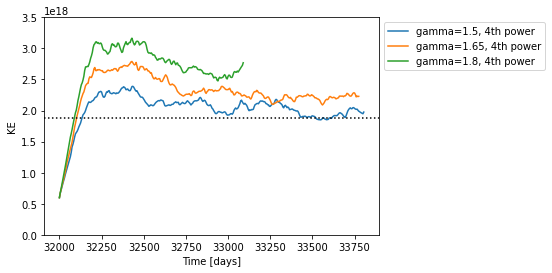

In [10]:
def fun(ds):
    return ds.KE.sum('Layer')
#    return ds.APE.sum('Interface')
#fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_reynolds_Klower/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.8')
#fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_reynolds_Klower_1.5/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.5')
# fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_reynolds_Klower_1.2/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.2')
# fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_reynolds_Klower_Rdiss_0.5/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.8, $R_{diss}=0.5$')
# fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_reynolds_Klower_Rdiss_0.1/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.8, $R_{diss}=0.1$')
#fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_reynolds_Klower_new_cdiss/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.8, 2nd power')
#fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_reynolds_Klower_1.5_new_cdiss/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.5, 2nd power')
fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/ZB_reynolds_1.5/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.5, 4th power')
fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/ZB_reynolds_1.65/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.65, 4th power')
fun(xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/ZB_reynolds_1.8/output/ocean.stats.nc', decode_times=False)).plot(label='gamma=1.8, 4th power')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18])
#plt.axhline(y=0.9e+20, color='k', ls=':')
plt.legend(bbox_to_anchor=(1,1))

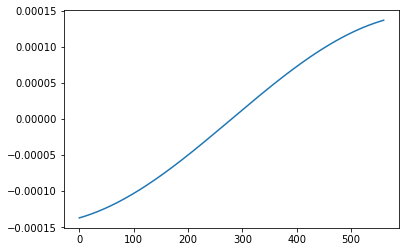

In [175]:
plt.plot(np.sort(np.unique(static.Coriolis)))

In [176]:
1/(2*600)

0.0008333333333333334

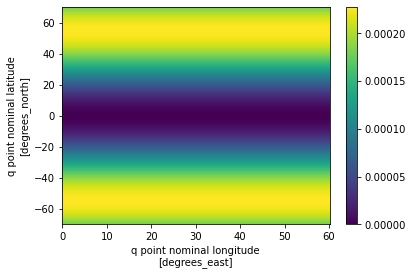

In [88]:
dudt.plot()

In [17]:
ds = xr.open_mfdataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_reynolds_Klower_1.5/output/ocean.stats.nc', decode_times=False)
bare = xr.open_mfdataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4/bare/output/ocean.stats.nc', decode_times=False)

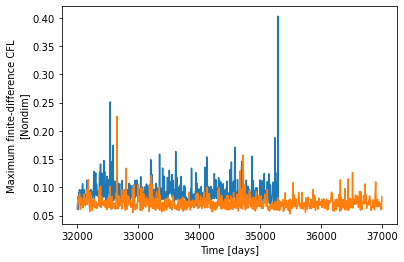

In [18]:
ds.max_CFL_lin.plot()
bare.max_CFL_lin.plot()

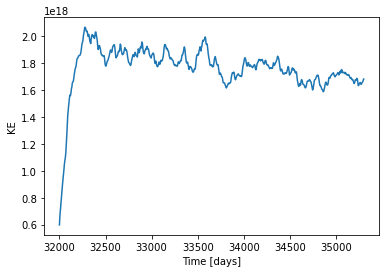

In [16]:
ds.KE.sum('Layer').plot()

In [184]:
ds = xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/Instability_testing/snapshots_49621620.nc', decode_times=False)

In [185]:
ds

<xarray.Dataset>
Dimensions:            (xq: 241, yh: 560, zl: 15, time: 1, xh: 240, yq: 561, zi: 16)
Coordinates:
  * xq                 (xq) float64 0.0 0.25 0.5 0.75 ... 59.25 59.5 59.75 60.0
  * yh                 (yh) float64 -69.88 -69.62 -69.38 ... 69.38 69.62 69.88
  * zl                 (zl) float64 1.023e+03 1.023e+03 ... 1.028e+03 1.028e+03
  * time               (time) float64 3.446e+04
  * xh                 (xh) float64 0.125 0.375 0.625 ... 59.38 59.62 59.88
  * yq                 (yq) float64 -70.0 -69.75 -69.5 ... 69.5 69.75 70.0
  * zi                 (zi) float64 1.022e+03 1.023e+03 ... 1.028e+03 1.028e+03
Data variables: (12/18)
    u                  (time, zl, yh, xq) float32 ...
    v                  (time, zl, yq, xh) float32 ...
    h                  (time, zl, yh, xh) float32 ...
    e                  (time, zi, yh, xh) float64 ...
    RV                 (time, zl, yq, xq) float32 ...
    diffu              (time, zl, yh, xq) float32 ...
    ...                 ...
    KE_horvisc         (time, zl, yh, xh) float32 ...
    c_diss             (time, zl, yh, xh) float32 ...
    S_11               (time, zl, yh, xh) float32 ...
    S_22               (time, zl, yh, xh) float32 ...
    S_12               (time, zl, yq, xq) float32 ...
    visc_limit_h_frac  (time, zl, yh, xh) float32 ...
Attributes:
    filename:          snapshots_49621620.nc
    title:             NeverWorld2
    associated_files:  area_t: static.nc
    grid_type:         regular
    grid_tile:         N/A

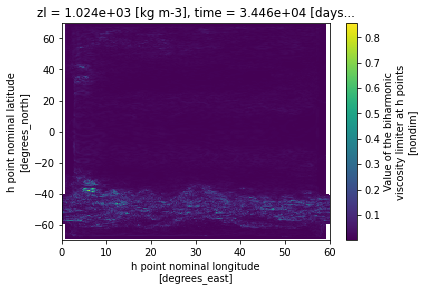

In [200]:
ds.visc_limit_h_frac.isel(zl=3).plot()

In [2]:
#ds = xr.open_mfdataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/stability_scheme_0/ocean.stats.nc', decode_times=False)
ds = xr.open_mfdataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/stability_visc/ocean.stats.nc', decode_times=False)

In [3]:
(ds.KE.sum('Layer').hvplot() + \
ds.max_CFL_lin.hvplot()).cols(1)

:Layout
   .Curve.I  :Curve   [Time]   (KE)
   .Curve.II :Curve   [Time]   (max_CFL_lin)

In [87]:
ds = xr.open_mfdataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/stability_CFL_0.02/output/snapshots_00033120.nc', decode_times=False)

In [90]:
size = {'width': 300, 'height': 600, 'colorbar': True}
(
# (ds.ZB2020u.hvplot(x='xq', y='yh', cmap='bwr', label='du/dt', **size) + \
# (ds.u).hvplot(x='xq', y='yh', clim=(-1,1), cmap='bwr', label='Zonal velocity', **size) + \
# ds.h.hvplot(x='xh', y='yh', cmap='inferno', label='Thickness', **size) + \
ds.S_11.hvplot(x='xh', y='yh', cmap='bwr', label='T_{xx}', **size) + \
ds.S_22.hvplot(x='xh', y='yh', cmap='bwr', label='T_{yy}', **size) + \
ds.S_12.hvplot(x='xq', y='yq', cmap='bwr', label='T_{xy}', **size) + \
ds.c_diss.hvplot(x='xh', y='yh', cmap='viridis', clim=(0,1), label='c_diss', **size) + \
ds.ZB2020u.hvplot(x='xq', y='yh', cmap='bwr', label='du/dt', **size) + \
ds.ZB2020v.hvplot(x='xh', y='yq', cmap='bwr', label='dv/dt', **size)
#(ds.visc_limit_h_frac<0.25).hvplot(x='xh', y='yh', cmap='viridis', clim=(0,1), label='Viscous limit mask', **size)
).cols(3)


:Layout
   .DynamicMap.I   :DynamicMap   [time,zl]
      :Image   [xh,yh]   (S_11)
   .DynamicMap.II  :DynamicMap   [time,zl]
      :Image   [xh,yh]   (S_22)
   .DynamicMap.III :DynamicMap   [time,zl]
      :Image   [xq,yq]   (S_12)
   .DynamicMap.IV  :DynamicMap   [time,zl]
      :Image   [xh,yh]   (c_diss)
   .DynamicMap.V   :DynamicMap   [time,zl]
      :Image   [xq,yh]   (ZB2020u)
   .DynamicMap.VI  :DynamicMap   [time,zl]
      :Image   [xh,yq]   (ZB2020v)

# Best stable simulations

(0.0, 3.5e+18)

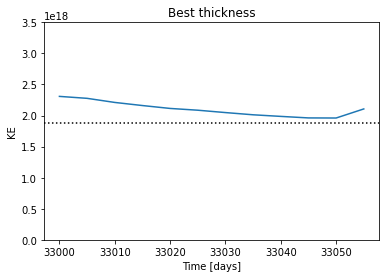

In [46]:
KE = xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Thickness/outcrop_10/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot()
plt.title('Best thickness')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18])

(0.0, 3.5e+18)

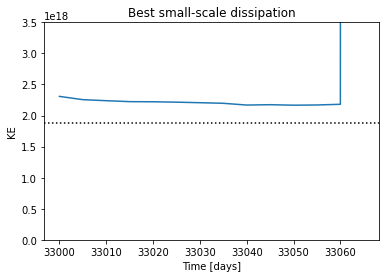

In [45]:
KE = xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Dissipation/ssd/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot()
plt.title('Best small-scale dissipation')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18])

(0.0, 3.5e+18)

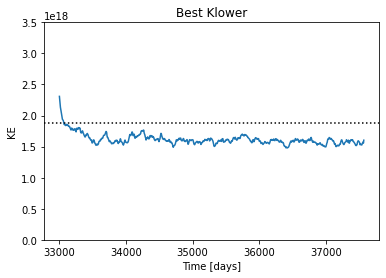

In [139]:
KE = xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Klower/Rdiss_0.5/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot()
plt.title('Best Klower')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18])

(0.0, 3.5e+18)

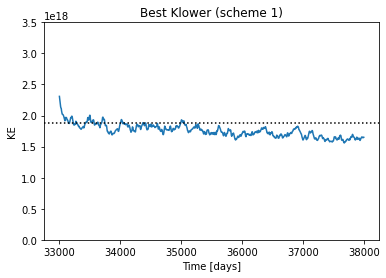

In [47]:
KE = xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Klower_1/Rdiss_0.5/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot()
plt.title('Best Klower (scheme 1)')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18])

(0.0, 3.5e+18)

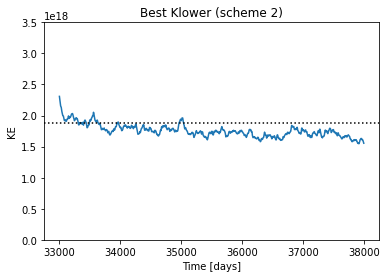

In [51]:
KE = xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Klower_2/Rdiss_0.1/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot()
plt.title('Best Klower (scheme 2)')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18])

(0.0, 3.5e+18)

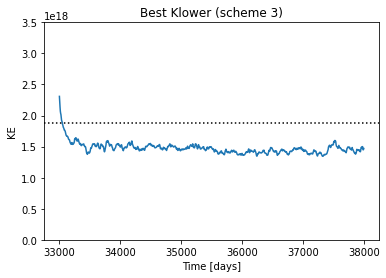

In [54]:
KE = xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Klower_3/Rdiss_0.1/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot()
plt.title('Best Klower (scheme 3)')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18])

(0.0, 3.5e+18)

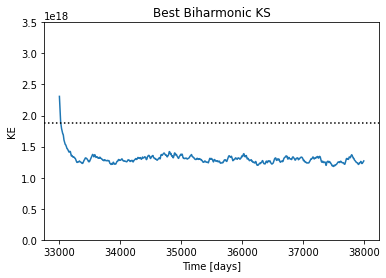

In [57]:
KE = xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Biharmonic_KS/stability_KS_0.05/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot()
plt.title('Best Biharmonic KS')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18])

(0.0, 3.5e+18)

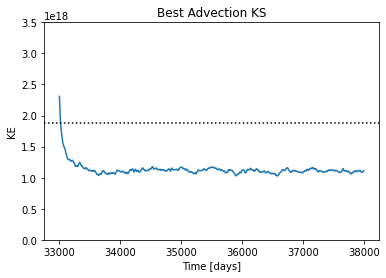

In [59]:
KE = xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Advection_KS/stability_CFL_0.005/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot()
plt.title('Best Advection KS')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18])

In [141]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})

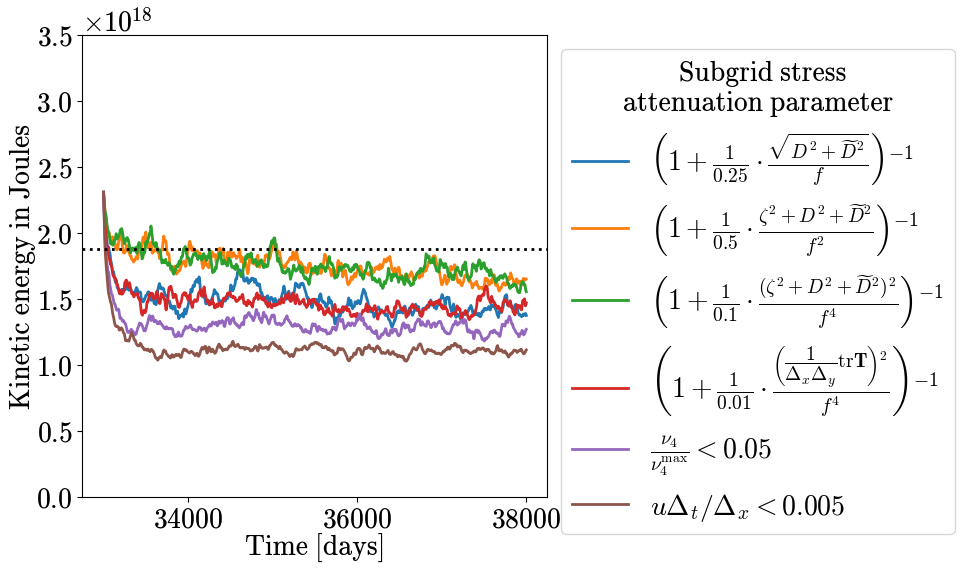

In [178]:
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Klower/Rdiss_0.25/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='$\\left(1+\\frac{1}{0.25}\cdot\\frac{\sqrt{D^2 + \widetilde{D}^2}}{f}\\right)^{-1}$')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Klower_1/Rdiss_0.5/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='$\\left(1+\\frac{1}{0.5}\cdot\\frac{\zeta^2 +  D^2 + \widetilde{D}^2}{f^2}\\right)^{-1}$')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Klower_2/Rdiss_0.1/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='$\\left(1+\\frac{1}{0.1}\cdot\\frac{(\zeta^2 +  D^2 + \widetilde{D}^2)^2}{f^4}\\right)^{-1}$')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Klower_3/Rdiss_0.1/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='$\\left(1+\\frac{1}{0.01}\cdot \\frac{\\left(\\dfrac{1}{\Delta_{x} \Delta_{y}} \mathrm{tr} \\mathbf{T} \\right)^2}{f^4} \\right)^{-1}$')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Biharmonic_KS/stability_KS_0.05/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='$\\frac{\\nu_4}{\\nu_4^{\mathrm{max}}}<0.05$')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Advection_KS/stability_CFL_0.005/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='$u \Delta_t / \Delta_x < 0.005$')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.savefig('Stability.pdf')

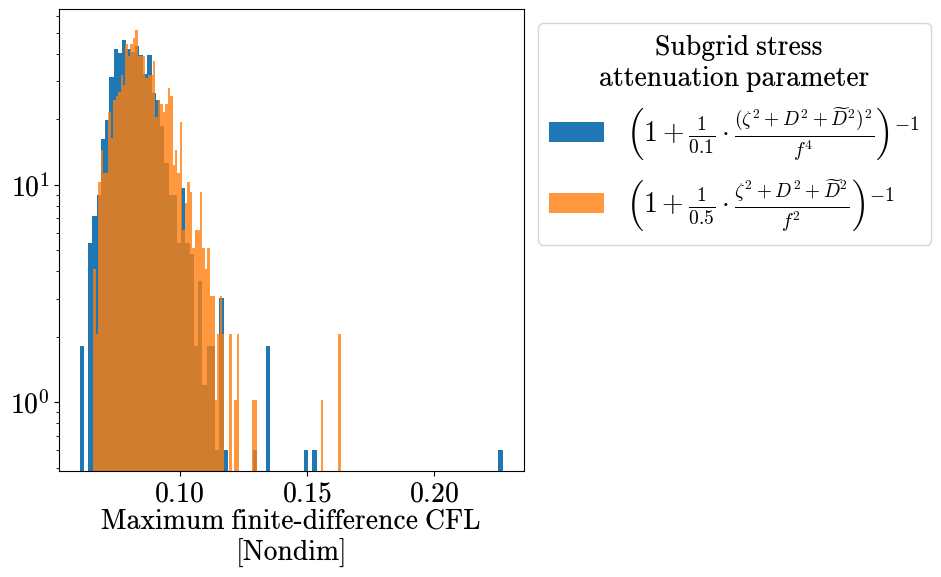

In [173]:
#xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Klower/Rdiss_0.25/output/ocean.stats.nc', decode_times=False).max_CFL_lin.plot.hist(bins=30,label='$\\left(1+\\frac{1}{0.25}\cdot\\frac{\sqrt{D^2 + \widetilde{D}^2}}{f}\\right)^{-1}$')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Klower_2/Rdiss_0.1/output/ocean.stats.nc', decode_times=False).max_CFL_lin.plot.hist(bins=100,density=True,alpha=1.0,label='$\\left(1+\\frac{1}{0.1}\cdot\\frac{(\zeta^2 +  D^2 + \widetilde{D}^2)^2}{f^4}\\right)^{-1}$')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Klower_1/Rdiss_0.5/output/ocean.stats.nc', decode_times=False).max_CFL_lin.plot.hist(bins=100,density=True,alpha=0.8,label='$\\left(1+\\frac{1}{0.5}\cdot\\frac{\zeta^2 +  D^2 + \widetilde{D}^2}{f^2}\\right)^{-1}$')
# xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Klower_3/Rdiss_0.1/output/ocean.stats.nc', decode_times=False).max_CFL_lin.plot.hist(bins=30,label='$\\left(1+\\frac{1}{0.01}\cdot \\frac{\\left(\\dfrac{1}{\Delta_{x} \Delta_{y}} \mathrm{tr} \\mathbf{T} \\right)^2}{f^4} \\right)^{-1}$')
# xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Biharmonic_KS/stability_KS_0.05/output/ocean.stats.nc', decode_times=False).max_CFL_lin.plot.hist(bins=30,label='$\\frac{\\nu_4}{\\nu_4^{\mathrm{max}}}<0.05$')
# xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Advection_KS/stability_CFL_0.005/output/ocean.stats.nc', decode_times=False).max_CFL_lin.plot.hist(bins=30,label='$u \Delta_t / \Delta_x < 0.005$')
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
#plt.ylabel('Kinetic energy in Joules')
plt.yscale('log')

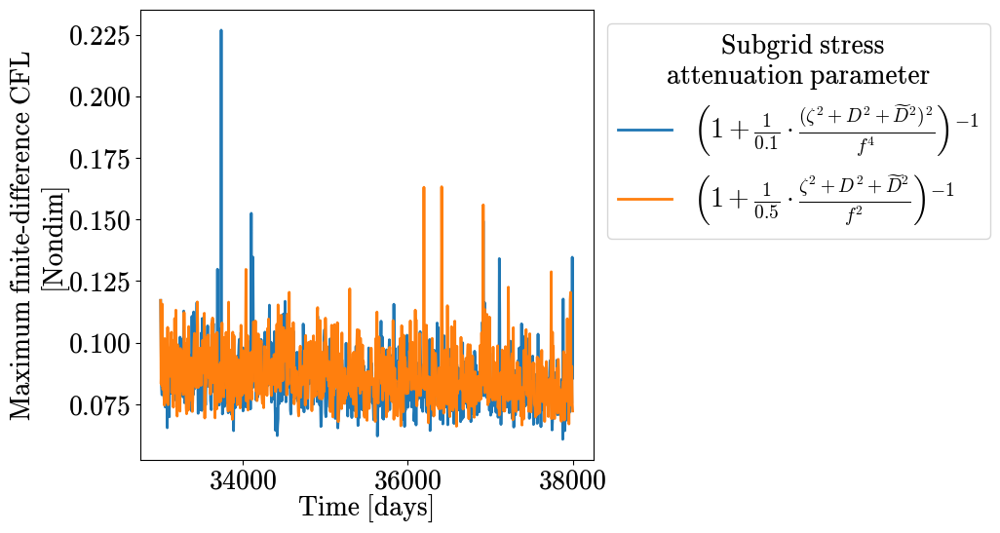

In [169]:
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Klower_2/Rdiss_0.1/output/ocean.stats.nc', decode_times=False).max_CFL_lin.plot(label='$\\left(1+\\frac{1}{0.1}\cdot\\frac{(\zeta^2 +  D^2 + \widetilde{D}^2)^2}{f^4}\\right)^{-1}$')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability/Klower_1/Rdiss_0.5/output/ocean.stats.nc', decode_times=False).max_CFL_lin.plot(label='$\\left(1+\\frac{1}{0.5}\cdot\\frac{\zeta^2 +  D^2 + \widetilde{D}^2}{f^2}\\right)^{-1}$')
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')

In [3]:
ds = xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_stability_ucode/Klower/R-0.5/snapshots_00033330.nc', decode_times=False)

In [4]:
(ds.c_diss.hvplot(x='xh', y='yh', clim=(0,1), width=300, height=600, cmap='viridis') + \
ds.S_11.hvplot(x='xh', y='yh', width=300, height=600) + \
ds.S_22.hvplot(x='xh', y='yh', width=300, height=600) + \
ds.S_12.hvplot(x='xq', y='yq', width=300, height=600)).cols(2)

:Layout
   .DynamicMap.I   :DynamicMap   [time,zl]
      :Image   [xh,yh]   (c_diss)
   .DynamicMap.II  :DynamicMap   [time,zl]
      :Image   [xh,yh]   (S_11)
   .DynamicMap.III :DynamicMap   [time,zl]
      :Image   [xh,yh]   (S_22)
   .DynamicMap.IV  :DynamicMap   [time,zl]
      :Image   [xq,yq]   (S_12)

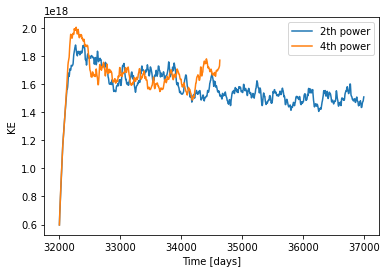

In [24]:
#xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_smooth_Klower/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot()
#xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_smooth_Klower_Rdiss_0.5/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot()
#xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_smooth_Klower_Rdiss_0.1/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot()
#xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_smooth_Klower_1.3/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot()
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_outcrop/ZB_smooth_Klower_1.3_new_cdiss/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='2th power')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4_4thpower/ZB_smooth_1.3/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='4th power')
plt.legend()

# Different approaches for stabilization. Another one trial

In [10]:
def get(exp='Klower/R-1.0'):
    return xr.open_dataset(f'/scratch/pp2681/mom6/Neverworld2/simulations/R4_smooth_1.7/{exp}/output/ocean.stats.nc', decode_times=False).KE.sum('Layer')


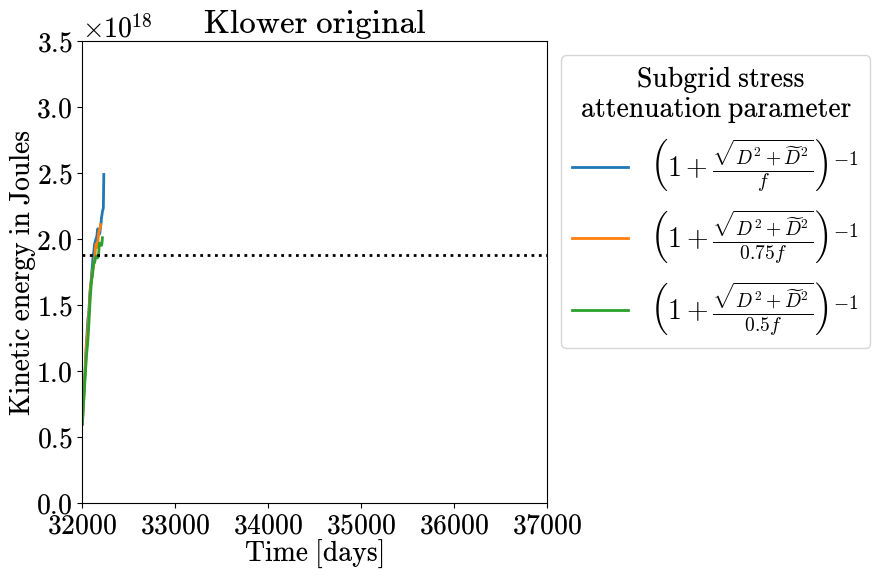

In [11]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})
get().plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{f}\\right)^{-1}$')
get('Klower/R-0.75').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.75f}\\right)^{-1}$')
get('Klower/R-0.5').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.5f}\\right)^{-1}$')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.title('Klower original')
plt.savefig('Smooth-1.7-stability-panel-1.pdf')

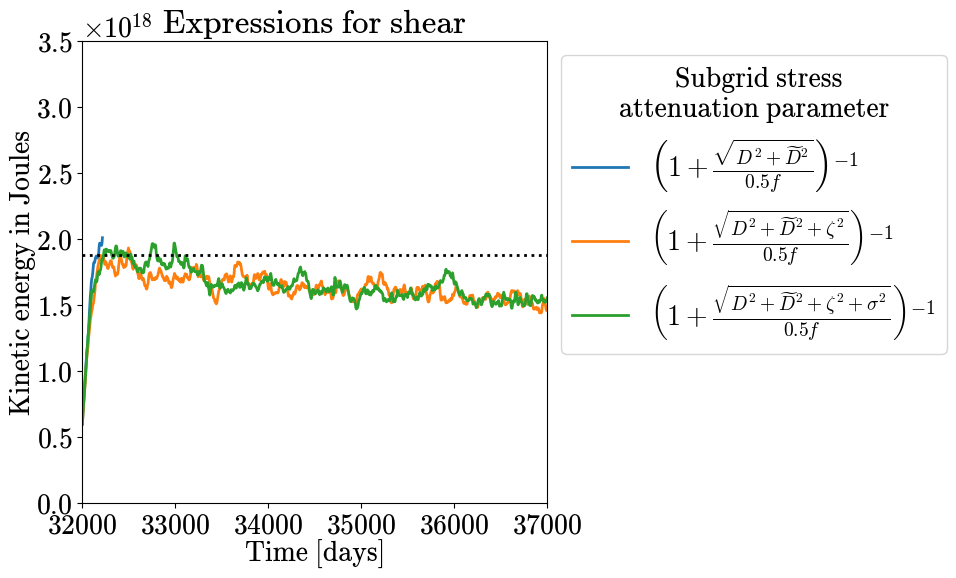

In [12]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})
get('Klower/R-0.5').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.5f}\\right)^{-1}$')
get('Klower-0.5/shear-1').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2+\zeta^2}}{0.5f}\\right)^{-1}$')
get('Klower-0.5/shear-2').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2+\zeta^2+\sigma^2}}{0.5f}\\right)^{-1}$')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.title('Expressions for shear')
plt.savefig('Smooth-1.7-stability-panel-2.pdf')

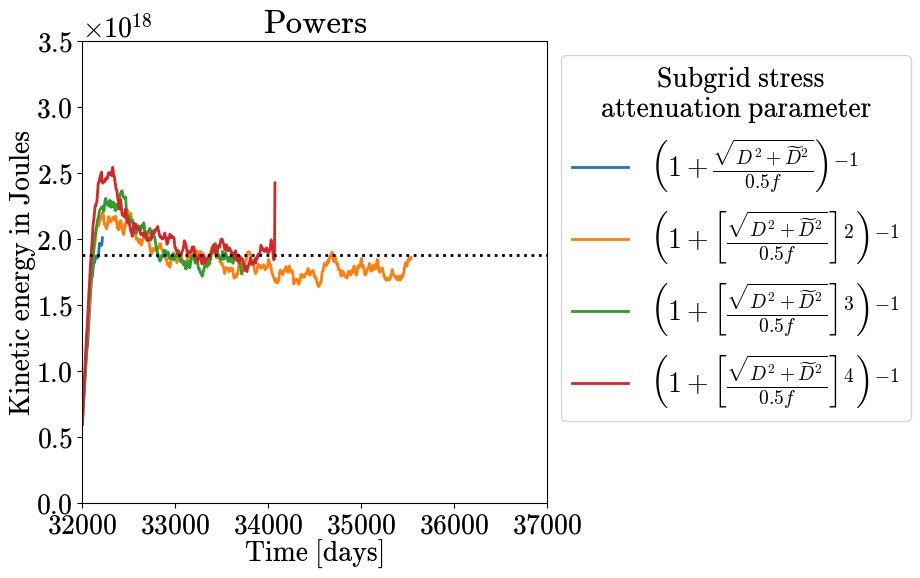

In [66]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})
get('Klower/R-0.5').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.5f}\\right)^{-1}$')
get('Klower-0.5/power-2').plot(label='$\\left(1+\\left[\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.5f}\\right]^2\\right)^{-1}$')
get('Klower-0.5/power-3').plot(label='$\\left(1+\\left[\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.5f}\\right]^3\\right)^{-1}$')
get('Klower-0.5/power-4').plot(label='$\\left(1+\\left[\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.5f}\\right]^4\\right)^{-1}$')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.title('Powers')
plt.savefig('Smooth-1.7-stability-panel-3.pdf')

Text(0.5, 1.0, 'Smoothing')

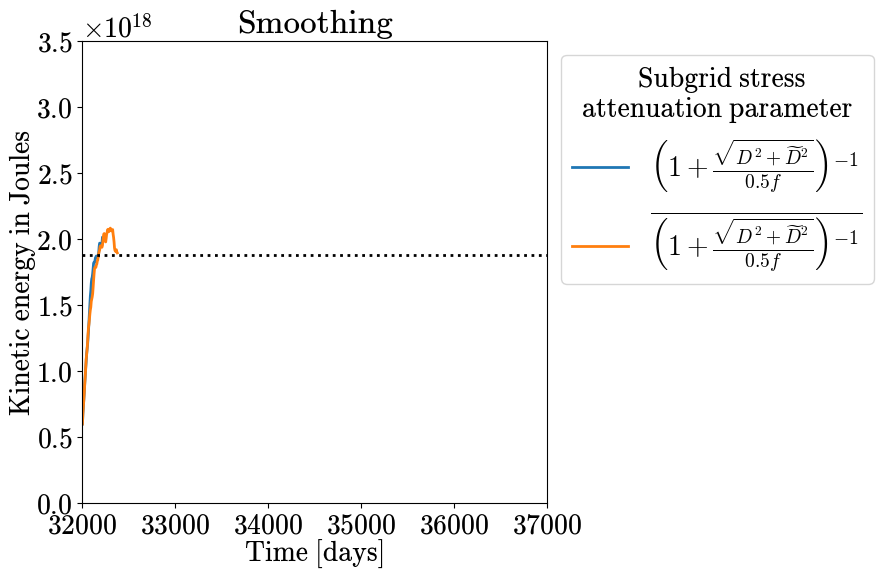

In [51]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})
get('Klower/R-0.5').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.5f}\\right)^{-1}$')
get('Klower-0.5/smooth').plot(label='$\overline{\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.5f}\\right)^{-1}}$')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.title('Smoothing')

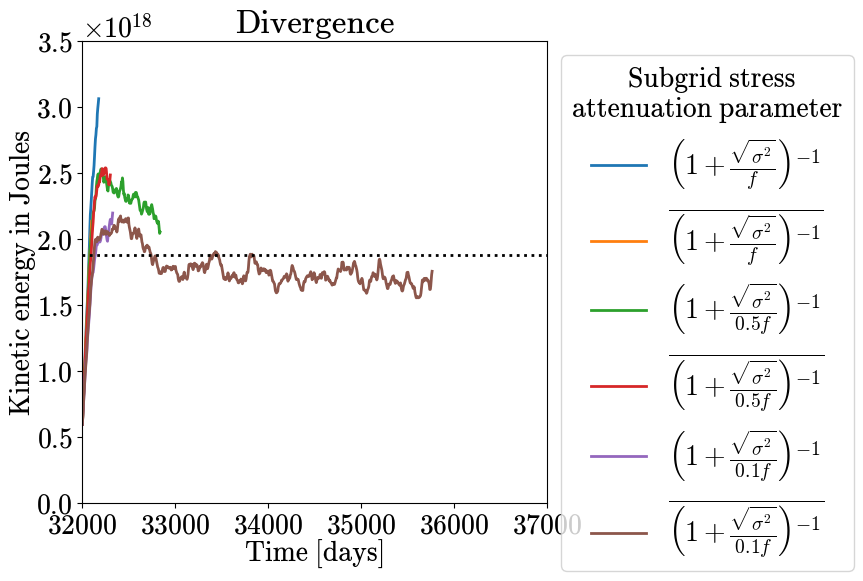

In [67]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})
get('Klower_div/R-1.0').plot(label='$\\left(1+\\frac{\sqrt{\sigma^2}}{f}\\right)^{-1}$')
get('Klower_div/R-1.0-smooth').plot(label='$\overline{\\left(1+\\frac{\sqrt{\sigma^2}}{f}\\right)^{-1}}$')

get('Klower_div/R-0.5').plot(label='$\\left(1+\\frac{\sqrt{\sigma^2}}{0.5f}\\right)^{-1}$')
get('Klower_div/R-0.5-smooth').plot(label='$\overline{\\left(1+\\frac{\sqrt{\sigma^2}}{0.5f}\\right)^{-1}}$')

get('Klower_div/R-0.1').plot(label='$\\left(1+\\frac{\sqrt{\sigma^2}}{0.1f}\\right)^{-1}$')
get('Klower_div/R-0.1-smooth').plot(label='$\overline{\\left(1+\\frac{\sqrt{\sigma^2}}{0.1f}\\right)^{-1}}$')


plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.title('Divergence')
plt.savefig('Smooth-1.7-stability-panel-4.pdf')

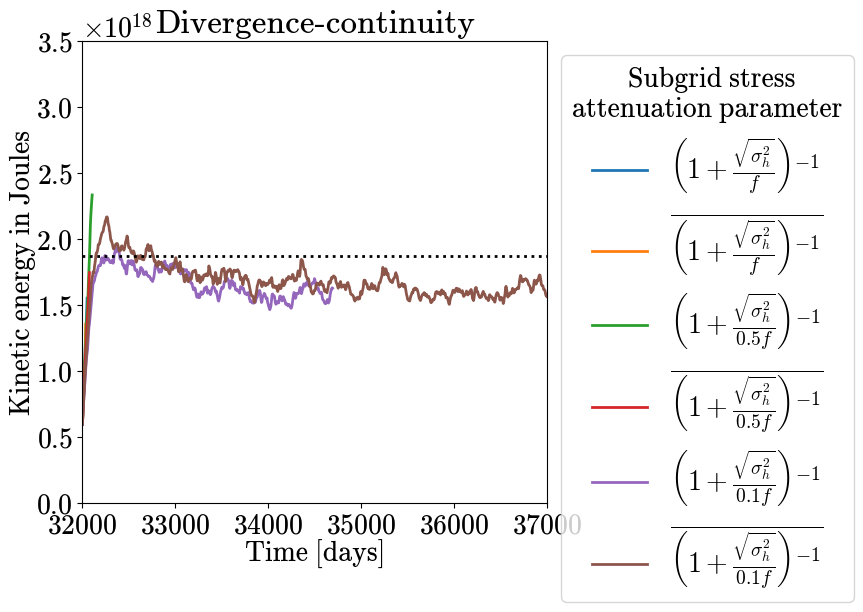

In [68]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})
get('Klower_divh/R-1.0').plot(label='$\\left(1+\\frac{\sqrt{\sigma_h^2}}{f}\\right)^{-1}$')
get('Klower_divh/R-1.0-smooth').plot(label='$\overline{\\left(1+\\frac{\sqrt{\sigma_h^2}}{f}\\right)^{-1}}$')

get('Klower_divh/R-0.5').plot(label='$\\left(1+\\frac{\sqrt{\sigma_h^2}}{0.5f}\\right)^{-1}$')
get('Klower_divh/R-0.5-smooth').plot(label='$\overline{\\left(1+\\frac{\sqrt{\sigma_h^2}}{0.5f}\\right)^{-1}}$')

get('Klower_divh/R-0.1').plot(label='$\\left(1+\\frac{\sqrt{\sigma_h^2}}{0.1f}\\right)^{-1}$')
get('Klower_divh/R-0.1-smooth').plot(label='$\overline{\\left(1+\\frac{\sqrt{\sigma_h^2}}{0.1f}\\right)^{-1}}$')


plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.title('Divergence-continuity')
plt.savefig('Smooth-1.7-stability-panel-5.pdf')

# ZB-Smooth 1.5

In [34]:
def get(exp='Klower/R-1.0'):
    return xr.open_dataset(f'/scratch/pp2681/mom6/Neverworld2/simulations/R4_smooth_1.5/{exp}/output/ocean.stats.nc', decode_times=False).KE.sum('Layer')

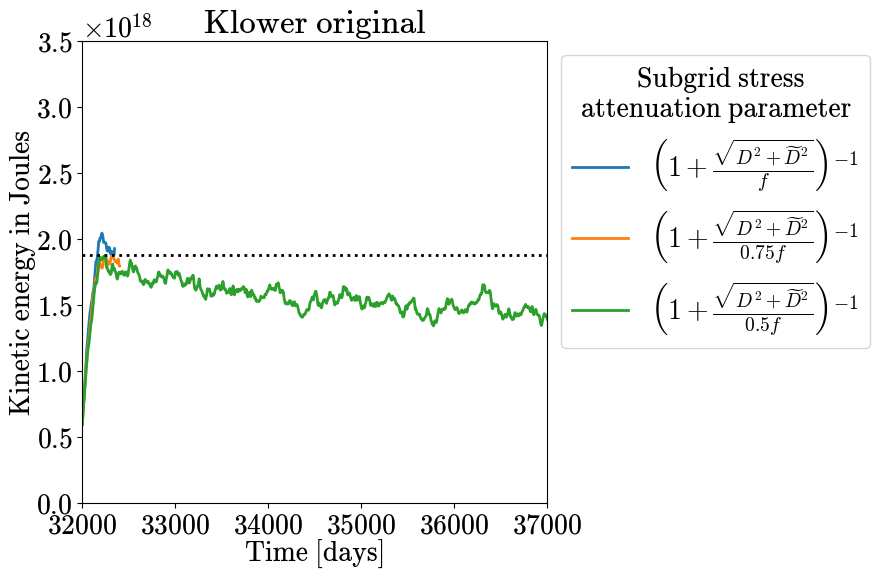

In [4]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})
get().plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{f}\\right)^{-1}$')
get('Klower/R-0.75').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.75f}\\right)^{-1}$')
get('Klower/R-0.5').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.5f}\\right)^{-1}$')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.title('Klower original')
#plt.savefig('Smooth-1.7-stability-panel-1.pdf')

Text(0.5, 1.0, 'Expressions for shear')

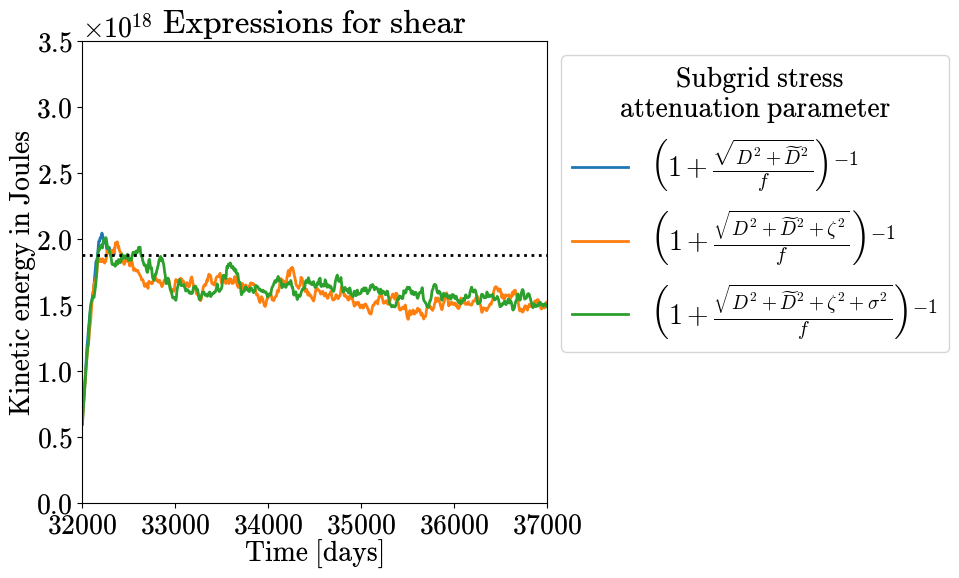

In [23]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})
get('Klower/R-1.0').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{f}\\right)^{-1}$')
get('Klower-1.0/shear-1').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2+\zeta^2}}{f}\\right)^{-1}$')
get('Klower-1.0/shear-2').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2+\zeta^2+\sigma^2}}{f}\\right)^{-1}$')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.title('Expressions for shear')
#plt.savefig('Smooth-1.7-stability-panel-2.pdf')

Text(0.5, 1.0, 'Powers')

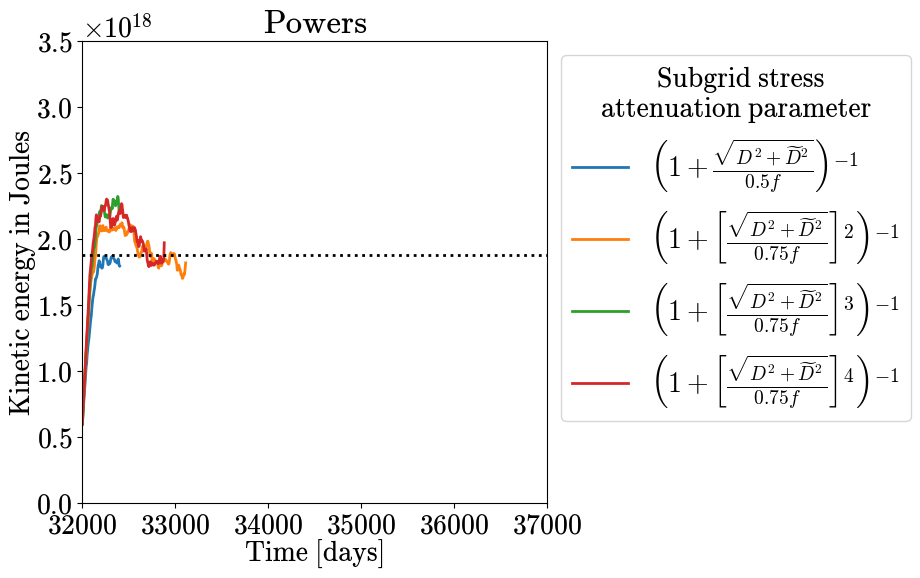

In [38]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})
get('Klower/R-0.75').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.5f}\\right)^{-1}$')
get('Klower-0.75/power-2').plot(label='$\\left(1+\\left[\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.75f}\\right]^2\\right)^{-1}$')
get('Klower-0.75/power-3').plot(label='$\\left(1+\\left[\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.75f}\\right]^3\\right)^{-1}$')
get('Klower-0.75/power-4').plot(label='$\\left(1+\\left[\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.75f}\\right]^4\\right)^{-1}$')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.title('Powers')

Text(0.5, 1.0, 'Smoothing')

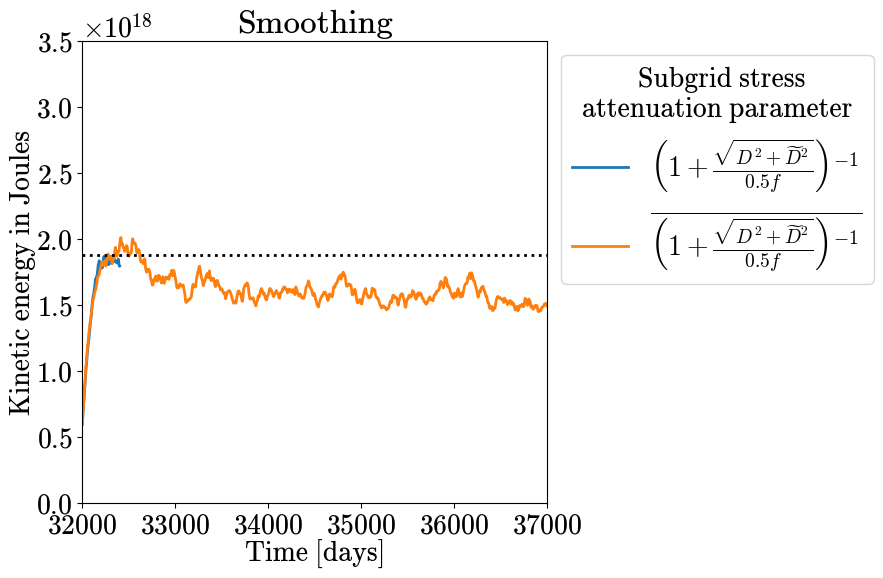

In [33]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})
get('Klower/R-0.75').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.5f}\\right)^{-1}$')
get('Klower-0.75/smooth').plot(label='$\overline{\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.5f}\\right)^{-1}}$')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.title('Smoothing')

Text(0.5, 1.0, 'Divergence')

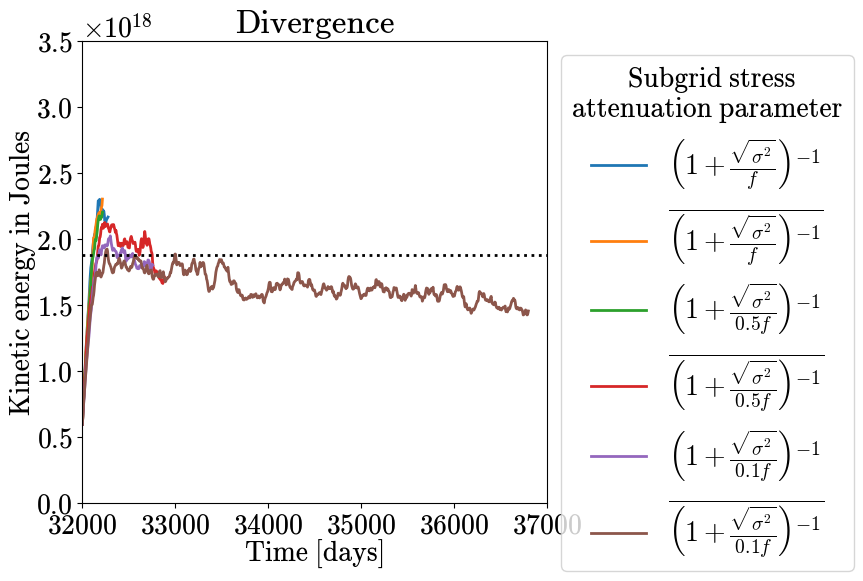

In [35]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})
get('Klower_div/R-1.0').plot(label='$\\left(1+\\frac{\sqrt{\sigma^2}}{f}\\right)^{-1}$')
get('Klower_div/R-1.0-smooth').plot(label='$\overline{\\left(1+\\frac{\sqrt{\sigma^2}}{f}\\right)^{-1}}$')

get('Klower_div/R-0.5').plot(label='$\\left(1+\\frac{\sqrt{\sigma^2}}{0.5f}\\right)^{-1}$')
get('Klower_div/R-0.5-smooth').plot(label='$\overline{\\left(1+\\frac{\sqrt{\sigma^2}}{0.5f}\\right)^{-1}}$')

get('Klower_div/R-0.1').plot(label='$\\left(1+\\frac{\sqrt{\sigma^2}}{0.1f}\\right)^{-1}$')
get('Klower_div/R-0.1-smooth').plot(label='$\overline{\\left(1+\\frac{\sqrt{\sigma^2}}{0.1f}\\right)^{-1}}$')


plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.title('Divergence')

Text(0.5, 1.0, 'Divergence-continuity')

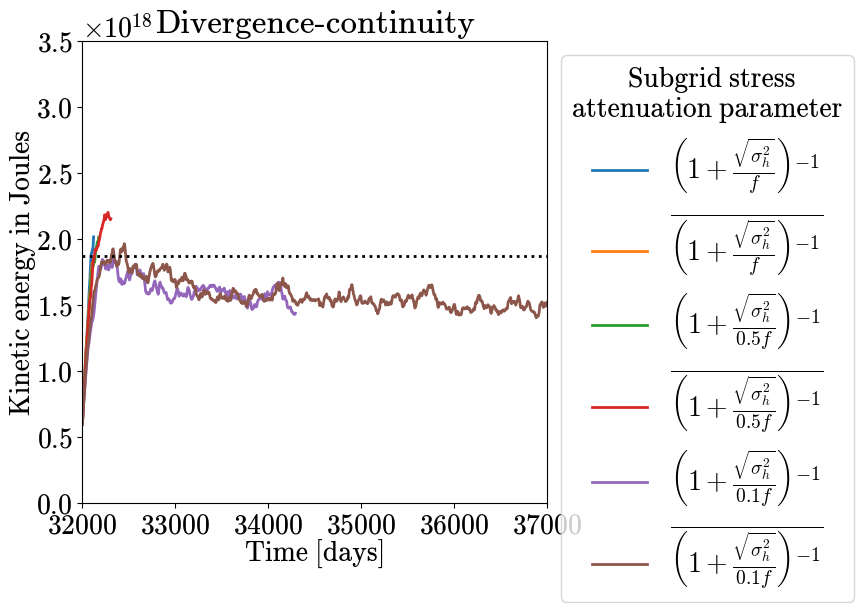

In [40]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})
get('Klower_divh/R-1.0').plot(label='$\\left(1+\\frac{\sqrt{\sigma_h^2}}{f}\\right)^{-1}$')
get('Klower_divh/R-1.0-smooth').plot(label='$\overline{\\left(1+\\frac{\sqrt{\sigma_h^2}}{f}\\right)^{-1}}$')

get('Klower_divh/R-0.5').plot(label='$\\left(1+\\frac{\sqrt{\sigma_h^2}}{0.5f}\\right)^{-1}$')
get('Klower_divh/R-0.5-smooth').plot(label='$\overline{\\left(1+\\frac{\sqrt{\sigma_h^2}}{0.5f}\\right)^{-1}}$')

get('Klower_divh/R-0.1').plot(label='$\\left(1+\\frac{\sqrt{\sigma_h^2}}{0.1f}\\right)^{-1}$')
get('Klower_divh/R-0.1-smooth').plot(label='$\overline{\\left(1+\\frac{\sqrt{\sigma_h^2}}{0.1f}\\right)^{-1}}$')


plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.title('Divergence-continuity')

Conclusions: full gradient helps, powers help, smoothing does not help

In [56]:
def get(exp='Klower-1.0/original'):
    return xr.open_dataset(f'/scratch/pp2681/mom6/Neverworld2/simulations/R4_smooth_1.3/{exp}/output/ocean.stats.nc', decode_times=False).KE.sum('Layer')

Text(0.5, 1.0, 'Powers')

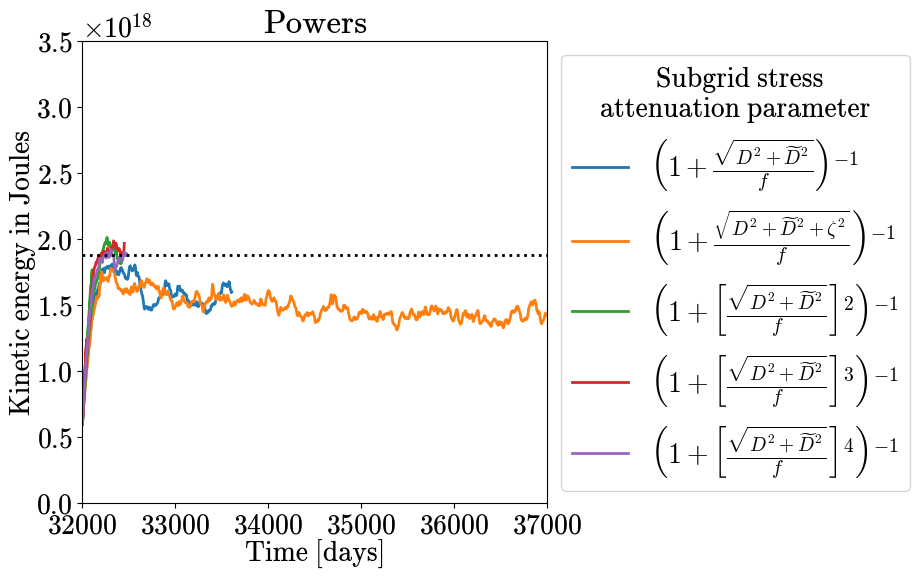

In [72]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})
get('Klower-1.0/original').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{f}\\right)^{-1}$')
get('Klower-1.0/shear-1').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2+\zeta^2}}{f}\\right)^{-1}$')
get('Klower-1.0/power-2').plot(label='$\\left(1+\\left[\\frac{\sqrt{D^2 + \widetilde{D}^2}}{f}\\right]^2\\right)^{-1}$')
get('Klower-1.0/power-3').plot(label='$\\left(1+\\left[\\frac{\sqrt{D^2 + \widetilde{D}^2}}{f}\\right]^3\\right)^{-1}$')
get('Klower-1.0/power-4').plot(label='$\\left(1+\\left[\\frac{\sqrt{D^2 + \widetilde{D}^2}}{f}\\right]^4\\right)^{-1}$')
#get('Klower-1.0/shear-2').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2+\zeta^2+\sigma^2}}{f}\\right)^{-1}$')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.title('Powers')

Text(0.5, 1.0, 'Powers')

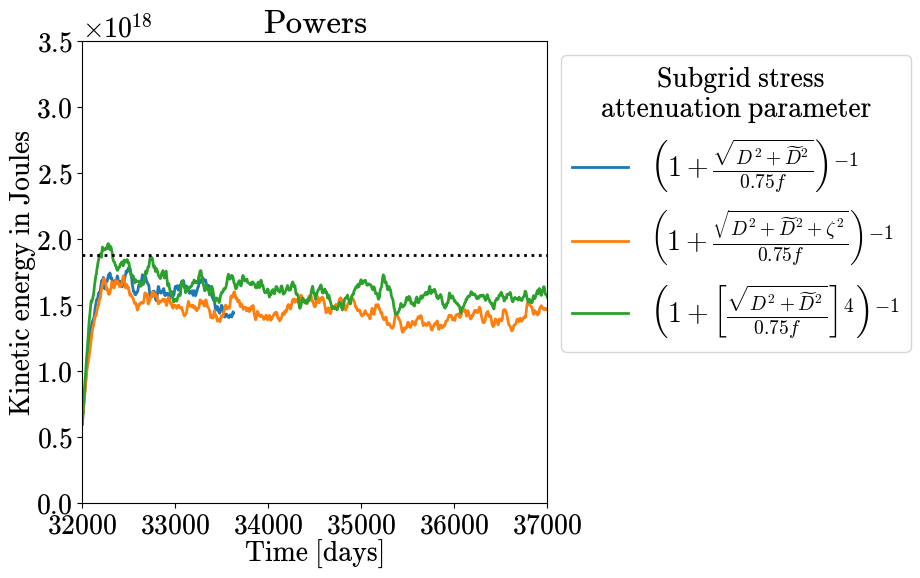

In [81]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})
get('Klower-0.75/original').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.75f}\\right)^{-1}$')
get('Klower-0.75/shear-1').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2+\zeta^2}}{0.75f}\\right)^{-1}$')
#get('Klower-0.75/power-2').plot(label='$\\left(1+\\left[\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.75f}\\right]^2\\right)^{-1}$')
#get('Klower-0.75/power-3').plot(label='$\\left(1+\\left[\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.75f}\\right]^3\\right)^{-1}$')
get('Klower-0.75/power-4').plot(label='$\\left(1+\\left[\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.75f}\\right]^4\\right)^{-1}$')
#get('Klower-1.0/shear-2').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2+\zeta^2+\sigma^2}}{f}\\right)^{-1}$')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.title('Powers')

Text(0.5, 1.0, 'Divergence')

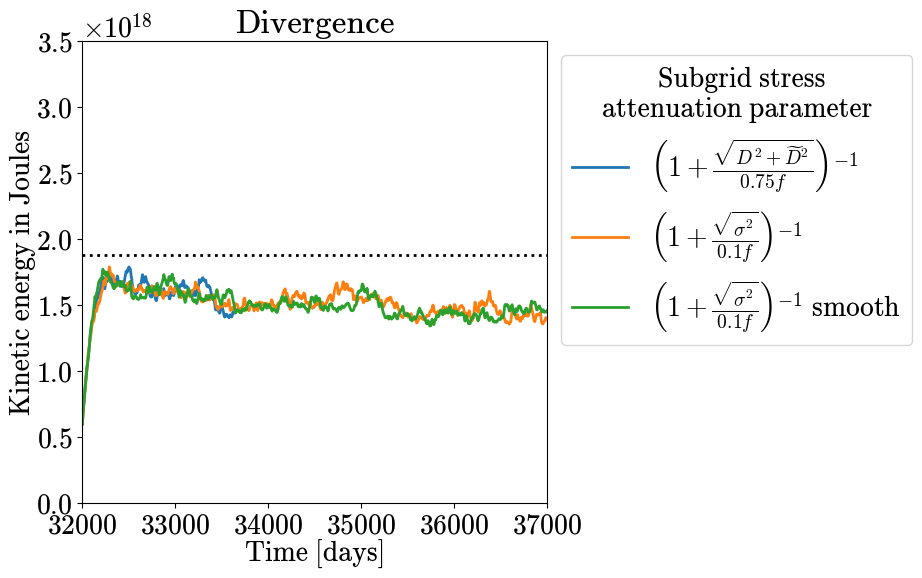

In [85]:
default_rcParams({'font.size': 20, 'figure.figsize': (6,6), 'axes.formatter.limits': (-5,5), 'lines.linewidth': 2})
get('Klower-0.75/original').plot(label='$\\left(1+\\frac{\sqrt{D^2 + \widetilde{D}^2}}{0.75f}\\right)^{-1}$')
get('Klower_div/R-0.1').plot(label='$\\left(1+\\frac{\sqrt{\sigma^2}}{0.1f}\\right)^{-1}$')
get('Klower_div/R-0.1-smooth').plot(label='$\\left(1+\\frac{\sqrt{\sigma^2}}{0.1f}\\right)^{-1}$ smooth')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])
plt.legend(bbox_to_anchor=(1,1), title='        Subgrid stress \nattenuation parameter')
plt.ylabel('Kinetic energy in Joules')
plt.title('Divergence')

# Geostrophic balance for trace tensor

In [139]:
ds = xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-final-simulations/Smooth-1.5/output/snapshots_00037850.nc', decode_times=False).squeeze()
static = xr.open_mfdataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4/bare/output/static.nc', decode_times=False)

In [108]:
P = ((ds.S_11 + ds.S_22)/2)

In [109]:
dPdx = (P[:,:,1:None].values - P[:,:,0:-1].values) + ds.ZB2020u.isel(xq=slice(1,-1))*0
dPdx = dPdx / static.dxCu

In [110]:
dPdy = (P[:,1:None,:].values - P[:,0:-1,:].values) + ds.ZB2020v.isel(yq=slice(1,-1))*0
dPdy = dPdy / static.dyCv

In [137]:
ug = + (remesh(static.Coriolis,ds.u))**(-1) * remesh(dPdy,ds.u)
vg = - (remesh(static.Coriolis,ds.v))**(-1) * remesh(dPdx,ds.v)

In [132]:
def logKEz(u,v):
    return np.log10(0.5 * (ds.h * (remesh(u**2, ds.e) + remesh(v**2, ds.e))).sum('zl'))

In [141]:
def logKE_nonz(u,v):
    return np.log10(0.5 * (ds.h * (remesh(u**2, ds.e) + remesh(v**2, ds.e))))

In [152]:
logKE  = logKE_nonz(ds.u,ds.v).compute()
logKEg = logKE_nonz(ug,vg).compute().values + logKE*0

In [158]:
ds.h.hvplot(x='xh', y='yh', cmap='inferno', width=300, height=700) + \
logKE.hvplot(x='xh', y='yh', clim=(-3,3), cmap='inferno', width=300, height=700) + \
logKEg.hvplot(x='xh', y='yh', clim=(-3,3), cmap='inferno', width=300, height=700)

:Layout
   .DynamicMap.I   :DynamicMap   [zl]
      :Image   [xh,yh]   (h)
   .DynamicMap.II  :DynamicMap   [zl]
      :Image   [xh,yh]   (value)
   .DynamicMap.III :DynamicMap   [zl]
      :Image   [xh,yh]   (value)

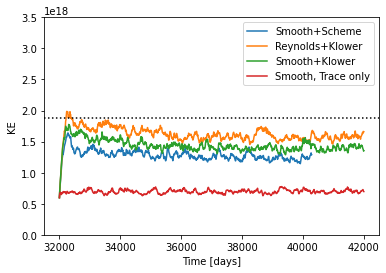

In [11]:
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Smooth-1.3-nstep/scheme/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Smooth+Scheme')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-final-simulations/Reynolds-1.5/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Reynolds+Klower')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-final-simulations/Smooth-1.3/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Smooth+Klower')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Smooth-1.3-nstep/trace-free/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Smooth, Trace only')
plt.legend()
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); #plt.xlim([32000,37000])


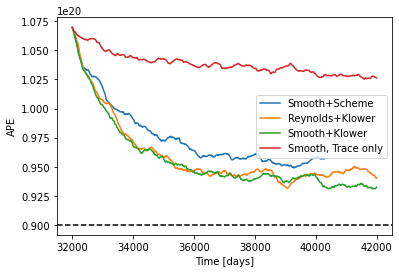

In [13]:
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Smooth-1.3-nstep/scheme/ocean.stats.nc', decode_times=False).APE.sum('Interface').plot(label='Smooth+Scheme')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-final-simulations/Reynolds-1.5/output/ocean.stats.nc', decode_times=False).APE.sum('Interface').plot(label='Reynolds+Klower')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-final-simulations/Smooth-1.3/output/ocean.stats.nc', decode_times=False).APE.sum('Interface').plot(label='Smooth+Klower')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Smooth-1.3-nstep/trace-free/output/ocean.stats.nc', decode_times=False).APE.sum('Interface').plot(label='Smooth, Trace only')
plt.legend()
#plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); #plt.xlim([32000,37000])
plt.axhline(y=0.9e+20, color='k', ls='--')

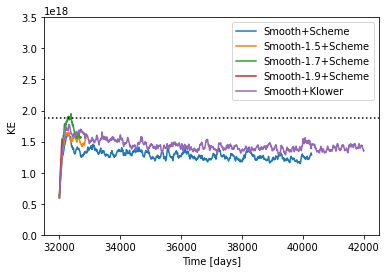

In [9]:
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Smooth-1.3-nstep/scheme/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Smooth+Scheme')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Scheme/Smooth-1.5-dt/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Smooth-1.5+Scheme')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Scheme/Smooth-1.7-dt/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Smooth-1.7+Scheme')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Scheme/Smooth-1.9-dt/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Smooth-1.9+Scheme')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-final-simulations/Smooth-1.3/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Smooth+Klower')
plt.legend()
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); #plt.xlim([32000,37000])


(32000.0, 37000.0)

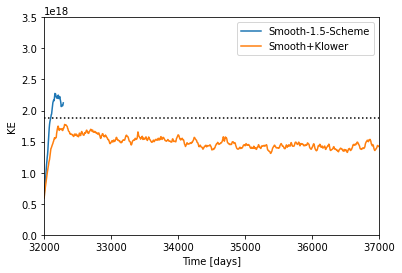

In [22]:
#xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Scheme/Reynolds-1.8-dt/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Reynolds-1.8-Scheme')
#xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Smooth-1.3-nstep/scheme/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Smooth+Scheme')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Scheme/Smooth-2.1/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Smooth-1.5-Scheme')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-final-simulations/Smooth-1.3/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Smooth+Klower')
#xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Scheme/Smooth-2.1-dt/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Smooth-1.5+Scheme')
plt.legend()
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); plt.xlim([32000,37000])


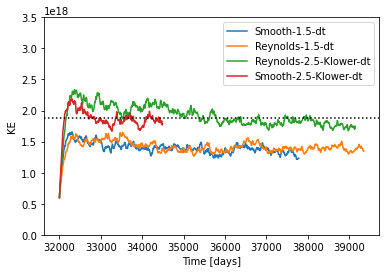

In [7]:
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Scheme/Smooth-1.5-dt/output/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Smooth-1.5-dt')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Scheme/Reynolds-1.5-dt/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Reynolds-1.5-dt')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Scheme/Reynolds-2.5-Klower-dt/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Reynolds-2.5-Klower-dt')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Scheme/Smooth-2.5-Klower-dt/ocean.stats.nc', decode_times=False).KE.sum('Layer').plot(label='Smooth-2.5-Klower-dt')
plt.axhline(y=1.877e+18, color='k', ls=':'); plt.ylim([0,3.5e+18]); #plt.xlim([32000,37000])
plt.legend()

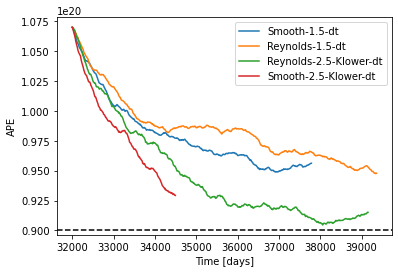

In [10]:
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Scheme/Smooth-1.5-dt/output/ocean.stats.nc', decode_times=False).APE.sum('Interface').plot(label='Smooth-1.5-dt')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Scheme/Reynolds-1.5-dt/ocean.stats.nc', decode_times=False).APE.sum('Interface').plot(label='Reynolds-1.5-dt')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Scheme/Reynolds-2.5-Klower-dt/ocean.stats.nc', decode_times=False).APE.sum('Interface').plot(label='Reynolds-2.5-Klower-dt')
xr.open_dataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-Scheme/Smooth-2.5-Klower-dt/ocean.stats.nc', decode_times=False).APE.sum('Interface').plot(label='Smooth-2.5-Klower-dt')
plt.axhline(y=0.9e+20, color='k', ls='--')
plt.legend()